<a href="https://colab.research.google.com/github/MadBunny999/ITMO-Road-vlm-assistant/blob/main/One_class_yolo_traffic_detection_baseline.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import json
!mkdir ~/.kaggle
!touch ~/.kaggle/kaggle.json
api_token = {"username":"dariaracionalna", "key":"15d1776c5c60b818cc3b4c387939be54"}

with open('/root/.kaggle/kaggle.json', 'w+') as file:
    json.dump(api_token, file)
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d watchman/rtsd-dataset
from zipfile import ZipFile
with ZipFile('rtsd-dataset.zip', 'r') as zip_ref:
    zip_ref.extractall()

100% 17.1G/17.1G [03:04<00:00, 129MB/s]
100% 17.1G/17.1G [03:05<00:00, 99.5MB/s]


In [ ]:
!pip install ultralytics
!pip install -e .
!pip install click
!pip install Sphinx
!pip install coverage
!pip install awscli
!pip install flake8
!pip install python-dotenv>=0.5.1
!pip install opencv-python~=4.8.1.78
!pip install pybboxes~=0.1.6

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 645.9/645.9 kB 8.7 MB/s eta 0:00:00
Obtaining file:///content
ERROR: file:///content does not appear to be a Python project: neither 'setup.py' nor 'pyproject.toml' found.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 227.5/227.5 kB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 14.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 52.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 548.2/548.2 kB 58.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.8/81.8 kB 14.1 MB/s eta 0:00:00
  Attempting uninstall: rsa
    Found existing installation: rsa 4.9
    Uninstalling rsa-4.9:
      Successfully uninstalled rsa-4.9
  Attempting uninstall: docutils
    Found existing installation: docutils 0.18.1
    Uninstalling docutils-0.18.1:
      Successfully uninstalled docutils-0.18.1
ERROR: pip's dependency resolver does not currently take into account all the p

In [ ]:
import os
import cv2
import random
import numpy as np
import pandas as pd
from tqdm import tqdm
import shutil
from shutil import copyfile
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')
from PIL import Image
import ultralytics
from ultralytics import YOLO
ultralytics.checks()
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import sys
import pybboxes as pbx
from google.colab.patches import cv2_imshow

import warnings
warnings.filterwarnings('ignore')

Ultralytics YOLOv8.0.219 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 62.1/78.2 GB disk)


In [ ]:
!pip install mlflow

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.0/19.0 MB 46.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 150.3/150.3 kB 19.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 24.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 226.8/226.8 kB 22.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 148.1/148.1 kB 22.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.2/80.2 kB 12.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 11.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 10.0 MB/s eta 0:00:00


In [ ]:
import mlflow
from ultralytics import settings

# Update a setting
settings.update({'mlflow': True})

# Reset settings to default values
settings.reset()

In [ ]:
mlflow.set_tracking_uri("http://5.9.178.136:5000/")

In [ ]:
data = pd.read_csv('/content/full-gt.csv')
data.head()

,filename,x_from,y_from,width,height,sign_class,sign_id
0,autosave01_02_2012_09_13_33.jpg,649,376,18,18,2_1,0
1,autosave01_02_2012_09_13_34.jpg,671,356,20,21,2_1,0
2,autosave01_02_2012_09_13_35.jpg,711,332,27,26,2_1,0
3,autosave01_02_2012_09_13_36.jpg,764,290,37,36,2_1,0
4,autosave01_02_2012_09_13_36.jpg,684,384,17,17,1_23,1


In [ ]:
!mkdir data
!rm /content/rtsd-dataset.zip

In [ ]:
COCO_LABELS_PATH = '/content/full-gt.csv'
IMAGES_DIR = '/content/rtsd-frames/rtsd-frames'
YOLO_LABELS_DIR = '/content/data'


def make_yolo_annotations(coco_labels_path, images_dir, yolo_labels_dir):
    """
    Creating yolo annotation .txt files from coco csv file (labels_path).
    Each row in coco csv file has the structure image_filename,x_lt, y_lt, width, height,
    classname, object_id

    :param coco_labels_path: Path to a labels.csv file of coco annotations
    :param images_dir: Path to an images directory. Needed to get image shape and transform coco
    to yolo
    :param yolo_labels_dir: Path to directory, where yolo .txt files will be stored.
    So create labels directory first
    :return: None
    """

    coco_anns = make_coco_dict(coco_labels_path, images_dir)
    count = 0

    for image_name, annotations in coco_anns.items():
        yolo_annotations = []
        count += 1

        if count % 10000 == 0:
            print("10000...")

        for coco_annotation in annotations:
            yolo_class, *coco_bbox = coco_annotation

            img_path = os.path.join(images_dir, image_name)
            img_width, img_height = cv2.imread(img_path).shape[:2][::-1]
            yolo_bbox = coco_to_yolo(*coco_bbox, img_width, img_height)

            yolo_bbox = [str(el) for el in yolo_bbox]
            yolo_annotation = "0" + " " + " ".join(yolo_bbox)
            yolo_annotations.append(yolo_annotation)

        yolo_annotations_text = "\n".join(yolo_annotations)
        label_name = image_name.replace("jpg", "txt")
        label_path = os.path.join(yolo_labels_dir, label_name)
        img_path = os.path.join(images_dir, image_name)

        if yolo_annotations_text:
            with open(label_path, "w") as label_file:
                print(yolo_annotations_text)
                print(label_path)
                print(img_path)
                label_file.write(yolo_annotations_text)


def make_coco_dict(coco_labels_path, images_dir):
    """
    Creating dictionary with coco annotations.

    :param coco_labels_path: Path to a labels.csv file of coco annotations
    :param images_dir: Path to an images directory. Needed to get image shape and transform coco
    to yolo
    :return: Dictionary with structure {image_filename: [[object_class, x_start, y_start, width, height]]}
    """

    images_anns = {image: [] for image in os.listdir(images_dir)}
    yolo_classes = {}
    yolo_classes_counter = 0

    with open(coco_labels_path) as f:
        _ = f.readline()

        for annotation in f:
            filename, x_from, y_from, width, height, sign_class, _ = annotation.split(",")

            if sign_class not in yolo_classes:
                yolo_classes[sign_class] = yolo_classes_counter
                yolo_classes_counter += 1

            images_anns[filename].append([
                yolo_classes[sign_class], int(x_from), int(y_from), int(width), int(height)
            ])
    return images_anns


def coco_to_yolo(x_start, y_start, width, height, img_width, img_height):
    """
    Making yolo bounding box from coco bounding box

    :param x_start: Top-left x
    :param y_start: Top-left y
    :param width: Bounding box width
    :param height: Bounding box height
    :param img_width: Image width
    :param img_height: Image height
    :return: Yolo bounding bbox. [x-c, y-c, w, h] Center coordinates & width & height
    """
    return pbx.convert_bbox((x_start, y_start, width, height),
                            from_type="coco", to_type="yolo", image_size=(img_width, img_height))


make_yolo_annotations(COCO_LABELS_PATH, IMAGES_DIR, YOLO_LABELS_DIR)

Выходные данные были обрезаны до нескольких последних строк (5000).
/content/rtsd-frames/rtsd-frames/autosave21_01_2013_11_13_33_0.jpg
0 0.6296875 0.6564814814814814 0.041666666666666664 0.08148148148148149
0 0.45390625 0.6425925925925926 0.03697916666666667 0.05555555555555555
0 0.45729166666666665 0.7342592592592593 0.034375 0.05740740740740741
0 0.014322916666666666 0.6953703703703704 0.028645833333333332 0.06296296296296296
/content/data/autosave16_04_2013_13_28_41_3.txt
/content/rtsd-frames/rtsd-frames/autosave16_04_2013_13_28_41_3.jpg
0 0.652734375 0.4388888888888889 0.02890625 0.05277777777777778
/content/data/autosave23_10_2012_12_48_27_0.txt
/content/rtsd-frames/rtsd-frames/autosave23_10_2012_12_48_27_0.jpg
0 0.15 0.4708333333333333 0.0234375 0.041666666666666664
/content/data/autosave10_10_2012_14_28_29_1.txt
/content/rtsd-frames/rtsd-frames/autosave10_10_2012_14_28_29_1.jpg
0 0.518359375 0.5486111111111112 0.02578125 0.027777777777777776
/content/data/autosave24_10_2013_13_1

In [ ]:
%ls

'=0.5.1'   datasets/     label_map.json   rtsd-frames/      train_anno_reduced.json
 data/     full-gt.csv   labels.txt       train_anno.json   val_anno.json


In [ ]:
!mkdir datasets
!mkdir datasets/train
!mkdir datasets/valid
!mkdir datasets/test

mkdir: cannot create directory ‘datasets’: File exists
mkdir: cannot create directory ‘datasets/train’: File exists
mkdir: cannot create directory ‘datasets/valid’: File exists
mkdir: cannot create directory ‘datasets/test’: File exists


In [ ]:
# srs_content=[]
# annotations = []
# images = []
# crsPath = '/content/ts/ts'
# train_ratio = 0.7
# valid_ratio = 0.2
# test_ratio = 0.1
# totalImgCount = len(os.listdir(crsPath))/2
# print(totalImgCount)

# for (dirname, dirs, files) in os.walk(crsPath):
#     for filename in files:
#         if filename.endswith('.txt'):
#             annotations.append(filename)
#         else:
#             images.append(filename)

# train_size = int(train_ratio * totalImgCount)
# valid_size = int(valid_ratio * totalImgCount)
# test_size = int(test_ratio * totalImgCount)

# print(train_size)
# print(valid_size)
# print(test_size)

In [ ]:
srs_content=[]
annotations = []
images = []
imgPath = '/content/rtsd-frames/rtsd-frames'
annoPath = '/content/data'
train_ratio = 0.7
valid_ratio = 0.2
test_ratio = 0.1
totalImg = os.listdir(imgPath)
totalAnno = os.listdir(annoPath)
totalImgCount = len(totalImg)
totalAnnoCount = len(totalAnno)
print(totalImgCount,totalAnnoCount)

train_size = int(train_ratio * totalAnnoCount)
valid_size = int(valid_ratio * totalAnnoCount)
test_size = int(test_ratio * totalAnnoCount)

print(train_size)
print(valid_size)
print(test_size)

179138 59188
41431
11837
5918


In [ ]:
!mkdir datasets/train/labels
!mkdir datasets/train/images
!mkdir datasets/valid/labels
!mkdir datasets/valid/images
!mkdir datasets/test/labels
!mkdir datasets/test/images

In [ ]:
from random import choice
trainimagePath = '/content/datasets/train/images'
trainlabelPath = '/content/datasets/train/labels'
valimagePath = '/content/datasets/valid/images'
vallabelPath = '/content/datasets/valid/labels'
testimagePath = '/content/datasets/test/images'
testlabelPath = '/content/datasets/test/labels'
#cycle for train dir
for x in range(train_size):

    fileTxt = choice(totalAnno) # get name of random image from origin dir
    fileJpg = fileTxt[:-4] +'.jpg' # get name of corresponding annotation file

    #move both files into train dir
    #shutil.move(os.path.join(crsPath, fileJpg), os.path.join(trainimagePath, fileJpg))
    #shutil.move(os.path.join(crsPath, fileXml), os.path.join(trainlabelPath, fileXml))
    shutil.copy(os.path.join(imgPath, fileJpg), os.path.join(trainimagePath, fileJpg))
    shutil.copy(os.path.join(annoPath, fileTxt), os.path.join(trainlabelPath, fileTxt))


    #remove files from arrays
    totalImg.remove(fileJpg)
    totalAnno.remove(fileTxt)

for x in range(valid_size):

    fileTxt = choice(totalAnno) # get name of random image from origin dir
    fileJpg = fileTxt[:-4] +'.jpg' # get name of corresponding annotation file

    #move both files into train dir
    #shutil.move(os.path.join(crsPath, fileJpg), os.path.join(trainimagePath, fileJpg))
    #shutil.move(os.path.join(crsPath, fileXml), os.path.join(trainlabelPath, fileXml))
    shutil.copy(os.path.join(imgPath, fileJpg), os.path.join(valimagePath, fileJpg))
    shutil.copy(os.path.join(annoPath, fileTxt), os.path.join(vallabelPath, fileTxt))


    #remove files from arrays
    totalImg.remove(fileJpg)
    totalAnno.remove(fileTxt)


#cycle for test dir
for x in range(test_size):

    fileTxt = choice(totalAnno) # get name of random image from origin dir
    fileJpg = fileTxt[:-4] +'.jpg' # get name of corresponding annotation file

    #move both files into train dir
    #shutil.move(os.path.join(crsPath, fileJpg), os.path.join(valimagePath, fileJpg))
    #shutil.move(os.path.join(crsPath, fileXml), os.path.join(vallabelPath, fileXml))
    shutil.copy(os.path.join(imgPath, fileJpg), os.path.join(testimagePath, fileJpg))
    shutil.copy(os.path.join(annoPath, fileTxt), os.path.join(testlabelPath, fileTxt))

    #remove files from arrays
    totalImg.remove(fileJpg)
    totalAnno.remove(fileTxt)

#rest of files will be validation files, so rename origin dir to val dir
#os.rename(crsPath, valPath)



In [ ]:
! rm -r /content/rtsd-frames

In [ ]:
import yaml

data_yaml = dict(
    train ='/content/datasets/train',
    val ='/content/datasets/valid',
    test='/content/datasets/test',
    nc =1,
    names =['traffic sign'
            ]
)

with open('data.yaml', 'w') as outfile:
    yaml.dump(data_yaml, outfile, default_flow_style=True)

%cat data.yaml

{names: [traffic sign], nc: 1, test: /content/datasets/test, train: /content/datasets/train,
  val: /content/datasets/valid}


In [ ]:
names =['traffic sign'
        ]
M=list(range(len(names)))
class_map=dict(zip(M,names))

In [ ]:
os.environ["MLFLOW_TRACKING_URI"] = "http://5.9.178.136:5000/"
NAME_EXPERIMENT = "base_yolo_traffic_detection"
mlflow.set_experiment(NAME_EXPERIMENT)

<Experiment: artifact_location='mlflow-artifacts:/2', creation_time=1700752181187, experiment_id='2', last_update_time=1700752181187, lifecycle_stage='active', name='base_yolo_traffic_detection', tags={}>

In [ ]:
model = YOLO("yolov8m.pt")

100%|██████████| 49.7M/49.7M [00:01<00:00, 26.2MB/s]


In [ ]:
# model.train(data="/content/data.yaml", imgsz=512, device=2, epochs=10)

Ultralytics YOLOv8.0.216 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:2 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/data.yaml, epochs=10, patience=50, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=2, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False,

100%|██████████| 755k/755k [00:00<00:00, 21.9MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 105MB/s]


AMP: checks passed ✅


train: Scanning /content/datasets/train/labels... 41431 images, 0 backgrounds, 0 corrupt: 100%|██████████| 41431/41431 [01:51<00:00, 370.99it/s]


train: New cache created: /content/datasets/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/datasets/valid/labels... 11837 images, 0 backgrounds, 0 corrupt: 100%|██████████| 11837/11837 [00:32<00:00, 359.16it/s]


val: New cache created: /content/datasets/valid/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      4.39G      1.271     0.8898     0.8652          6        512: 100%|██████████| 2590/2590 [22:17<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [04:05<00:00,  1.51it/s]


                   all      11837      20877      0.861      0.781       0.86      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      4.63G       1.24     0.7469     0.8584         10        512: 100%|██████████| 2590/2590 [21:45<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:55<00:00,  1.57it/s]


                   all      11837      20877      0.871      0.805      0.885      0.565

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      4.65G      1.175     0.6916     0.8522          8        512: 100%|██████████| 2590/2590 [21:21<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:57<00:00,  1.56it/s]


                   all      11837      20877      0.871      0.817      0.893      0.594

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      4.62G      1.125     0.6513     0.8403         16        512: 100%|██████████| 2590/2590 [21:22<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:57<00:00,  1.56it/s]


                   all      11837      20877      0.871      0.846       0.91      0.614

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      4.65G      1.089     0.6199     0.8353          8        512: 100%|██████████| 2590/2590 [21:22<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:59<00:00,  1.54it/s]


                   all      11837      20877      0.886       0.85      0.919      0.631

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      4.61G      1.058     0.5905     0.8322         10        512: 100%|██████████| 2590/2590 [21:17<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:54<00:00,  1.58it/s]


                   all      11837      20877      0.881      0.863      0.926      0.641

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      4.64G      1.021     0.5592     0.8262         11        512: 100%|██████████| 2590/2590 [21:18<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [04:02<00:00,  1.52it/s]


                   all      11837      20877      0.888      0.874      0.934      0.654

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      4.62G     0.9945     0.5344     0.8245         11        512: 100%|██████████| 2590/2590 [21:28<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:55<00:00,  1.57it/s]


                   all      11837      20877      0.888      0.884       0.94      0.667

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      4.65G     0.9686     0.5083     0.8194         12        512: 100%|██████████| 2590/2590 [21:37<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [04:04<00:00,  1.52it/s]


                   all      11837      20877      0.894      0.886      0.945      0.675

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      4.63G     0.9407     0.4863     0.8179         10        512: 100%|██████████| 2590/2590 [22:10<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [04:07<00:00,  1.49it/s]


                   all      11837      20877      0.898      0.892      0.949      0.685

10 epochs completed in 4.301 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train/weights/best.pt, 52.0MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.0.216 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:2 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [04:14<00:00,  1.45it/s]


                   all      11837      20877      0.898      0.892      0.949      0.685
Speed: 0.1ms preprocess, 4.0ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x78f4dcec1bd0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.048048, 

In [ ]:
import re

In [ ]:
def on_fit_epoch_end(trainer):
    if mlflow:
        metrics_dict = {f"{re.sub('[()]', '', k)}": float(v) for k, v in trainer.metrics.items()}
        mlflow.log_metrics(metrics=metrics_dict, step=trainer.epoch)

In [ ]:
RUN_NAME = "model_to_multiclass"

with mlflow.start_run(run_name=RUN_NAME):
    model.add_callback("on_fit_epoch_end",on_fit_epoch_end)
    results = model.train(data="/content/data.yaml", imgsz=512, device=0, epochs=5)

Ultralytics YOLOv8.0.219 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/data.yaml, epochs=5, patience=50, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None, format=torchscript, keras

100%|██████████| 755k/755k [00:00<00:00, 26.4MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

100%|██████████| 6.23M/6.23M [00:00<00:00, 107MB/s]


AMP: checks passed ✅


train: Scanning /content/datasets/train/labels... 41431 images, 0 backgrounds, 0 corrupt: 100%|██████████| 41431/41431 [01:57<00:00, 354.09it/s]


train: New cache created: /content/datasets/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/datasets/valid/labels... 11837 images, 0 backgrounds, 0 corrupt: 100%|██████████| 11837/11837 [00:32<00:00, 358.70it/s]


val: New cache created: /content/datasets/valid/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)


2023/11/27 15:37:35 INFO mlflow.tracking.fluent: Autologging successfully enabled for tensorflow.
2023/11/27 15:37:36 INFO mlflow.tracking.fluent: Autologging successfully enabled for statsmodels.
2023/11/27 15:37:37 INFO mlflow.tracking.fluent: Autologging successfully enabled for sklearn.
2023/11/27 15:37:37 WARNING mlflow.utils.autologging_utils: You are using an unsupported version of transformers. If you encounter errors during autologging, try upgrading / downgrading transformers to a supported version, or try upgrading MLflow.
2023/11/27 15:37:37 INFO mlflow.tracking.fluent: Autologging successfully enabled for transformers.


MLflow: logging run_id(8da2a86b8484494189ead6e994f47923) to http://5.9.178.136:5000/
MLflow: disable with 'yolo settings mlflow=False'
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5      4.39G      1.235     0.8223     0.8556         16        512: 100%|██████████| 2590/2590 [22:54<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [04:11<00:00,  1.47it/s]


                   all      11837      20914      0.854      0.766      0.854      0.542

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5      4.63G      1.187      0.704     0.8471         14        512: 100%|██████████| 2590/2590 [22:28<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [04:03<00:00,  1.52it/s]


                   all      11837      20914      0.872      0.823      0.898      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5      4.66G       1.12     0.6458      0.839         12        512: 100%|██████████| 2590/2590 [22:21<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [04:10<00:00,  1.48it/s]


                   all      11837      20914      0.871      0.849      0.912      0.626

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5      4.64G      1.058     0.5887     0.8315         20        512: 100%|██████████| 2590/2590 [22:11<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [04:03<00:00,  1.52it/s]


                   all      11837      20914      0.883      0.867      0.927      0.642

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5      4.65G      1.029     0.5702     0.8277         13        512: 100%|██████████| 2590/2590 [21:53<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:56<00:00,  1.56it/s]


                   all      11837      20914      0.889      0.871      0.933      0.653

5 epochs completed in 2.224 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train/weights/best.pt, 52.0MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.0.219 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 370/370 [03:58<00:00,  1.55it/s]


                   all      11837      20914      0.889      0.871      0.933      0.653
Speed: 0.1ms preprocess, 3.7ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/train
MLflow: results logged to http://5.9.178.136:5000/
MLflow: disable with 'yolo settings mlflow=False'


In [ ]:
best_path0='/content/runs/detect/train/weights/best.pt'
source0='/content/datasets/test/images'

In [ ]:
ppaths=[]
for dirname, _, filenames in os.walk(source0):
    for filename in filenames:
        if filename[-4:]=='.jpg':
            ppaths+=[(os.path.join(dirname, filename))]
ppaths=sorted(ppaths)
print(ppaths[0])
print(len(ppaths))

/content/datasets/test/images/autosave01_02_2012_09_13_35.jpg
5918


In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
!yolo task=detect mode=predict model={best_path0} conf=0.5 source={source0}

In [ ]:
model2 = YOLO(best_path0)
results = model2.predict(ppaths[:100],conf=0.5)
print(len(results))


0: 288x512 1 traffic sign, 1: 288x512 1 traffic sign, 2: 288x512 2 traffic signs, 3: 288x512 (no detections), 4: 288x512 2 traffic signs, 5: 288x512 3 traffic signs, 6: 288x512 1 traffic sign, 7: 288x512 2 traffic signs, 8: 288x512 2 traffic signs, 9: 288x512 3 traffic signs, 10: 288x512 (no detections), 11: 288x512 1 traffic sign, 12: 288x512 1 traffic sign, 13: 288x512 1 traffic sign, 14: 288x512 1 traffic sign, 15: 288x512 1 traffic sign, 16: 288x512 1 traffic sign, 17: 288x512 1 traffic sign, 18: 288x512 1 traffic sign, 19: 288x512 1 traffic sign, 20: 288x512 1 traffic sign, 21: 288x512 1 traffic sign, 22: 288x512 1 traffic sign, 23: 288x512 2 traffic signs, 24: 288x512 1 traffic sign, 25: 288x512 1 traffic sign, 26: 288x512 1 traffic sign, 27: 288x512 1 traffic sign, 28: 288x512 3 traffic signs, 29: 288x512 2 traffic signs, 30: 288x512 2 traffic signs, 31: 288x512 2 traffic signs, 32: 288x512 1 traffic sign, 33: 288x512 (no detections), 34: 288x512 1 traffic sign, 35: 288x512 4 t

In [ ]:
print((results[0].boxes.data))

tensor([[710.7522, 332.0107, 737.1335, 357.8048,   0.8204,   0.0000]], device='cuda:0')


In [ ]:
PBOX=pd.DataFrame(columns=range(6))
for i in range(len(results)):
    arri=pd.DataFrame(results[i].boxes.data.cpu().numpy()).astype(float)
    path=ppaths[i]
    file=path.split('/')[-1]
    arri=arri.assign(file=file)
    arri=arri.assign(i=i)
    PBOX=pd.concat([PBOX,arri],axis=0)
PBOX.columns=['x','y','x2','y2','confidence','class','file','i']
display(PBOX)

,x,y,x2,y2,confidence,class,file,i
0,710.752197,332.010681,737.133545,357.804840,0.820370,0.0,autosave01_02_2012_09_13_35.jpg,0.0
0,837.705139,301.381378,884.491638,343.900452,0.815741,0.0,autosave01_02_2012_09_13_39.jpg,1.0
0,730.558105,349.561401,755.412537,374.097534,0.826503,0.0,autosave01_02_2012_09_15_17.jpg,2.0
1,266.793915,390.820557,290.236084,416.272644,0.706494,0.0,autosave01_02_2012_09_15_17.jpg,2.0
0,810.682983,292.353271,842.981567,324.209839,0.796784,0.0,autosave01_02_2012_09_17_24.jpg,4.0
...,...,...,...,...,...,...,...,...
0,649.432983,376.932373,670.197449,397.731018,0.721157,0.0,autosave01_02_2012_10_27_51.jpg,96.0
0,852.436401,290.939453,932.763062,370.865509,0.885185,0.0,autosave01_02_2012_10_31_29.jpg,97.0
1,842.047424,203.160126,934.140320,286.307953,0.876856,0.0,autosave01_02_2012_10_31_29.jpg,97.0
0,827.816284,205.587250,905.821655,283.085907,0.849795,0.0,autosave01_02_2012_10_31_32.jpg,98.0


In [ ]:
PBOX['class']=PBOX['class'].apply(lambda x: class_map[int(x)])
PBOX=PBOX.reset_index(drop=True)
display(PBOX)
display(PBOX['class'].value_counts())

,x,y,x2,y2,confidence,class,file,i
0,710.752197,332.010681,737.133545,357.804840,0.820370,traffic sign,autosave01_02_2012_09_13_35.jpg,0.0
1,837.705139,301.381378,884.491638,343.900452,0.815741,traffic sign,autosave01_02_2012_09_13_39.jpg,1.0
2,730.558105,349.561401,755.412537,374.097534,0.826503,traffic sign,autosave01_02_2012_09_15_17.jpg,2.0
3,266.793915,390.820557,290.236084,416.272644,0.706494,traffic sign,autosave01_02_2012_09_15_17.jpg,2.0
4,810.682983,292.353271,842.981567,324.209839,0.796784,traffic sign,autosave01_02_2012_09_17_24.jpg,4.0
...,...,...,...,...,...,...,...,...
156,649.432983,376.932373,670.197449,397.731018,0.721157,traffic sign,autosave01_02_2012_10_27_51.jpg,96.0
157,852.436401,290.939453,932.763062,370.865509,0.885185,traffic sign,autosave01_02_2012_10_31_29.jpg,97.0
158,842.047424,203.160126,934.140320,286.307953,0.876856,traffic sign,autosave01_02_2012_10_31_29.jpg,97.0
159,827.816284,205.587250,905.821655,283.085907,0.849795,traffic sign,autosave01_02_2012_10_31_32.jpg,98.0


traffic sign    161
Name: class, dtype: int64

In [ ]:
def draw_box2(n0):

    ipath=ppaths[n0]
    image=cv2.imread(ipath)
    H,W=image.shape[0],image.shape[1]
    file=ipath.split('/')[-1]

    if PBOX[PBOX['file']==file] is not None:
        box=PBOX[PBOX['file']==file]
        box=box.reset_index(drop=True)
        #display(box)

        for i in range(len(box)):
            label=box.loc[i,'class']
            x=int(box.loc[i,'x'])
            y=int(box.loc[i,'y'])
            x2=int(box.loc[i,'x2'])
            y2=int(box.loc[i,'y2'])
            #print(label,x,y,x2,y2)
            '''cv2.putText(image, f'{label}', (x, int(y-4)),
                        cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0,255,0),2)'''
            cv2.rectangle(image,(x,y),(x2,y2),(0,255,0),2) #green

    #plt.imshow(image)
    #plt.show()

    return image

In [ ]:
def create_animation(ims):
    fig=plt.figure(figsize=(12,8))
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    text = plt.text(0.05, 0.05, f'Slide {0}', transform=fig.transFigure, fontsize=14, color='blue')
    plt.axis('off')
    plt.close()

    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        text.set_text(f'Slide {i}')
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000)

In [ ]:
images2=[]
for i in tqdm(range(len(ppaths[:100]))):
    images2+=[draw_box2(i)]

100%|██████████| 100/100 [00:01<00:00, 82.38it/s]


In [ ]:
from google.colab.patches import cv2_imshow

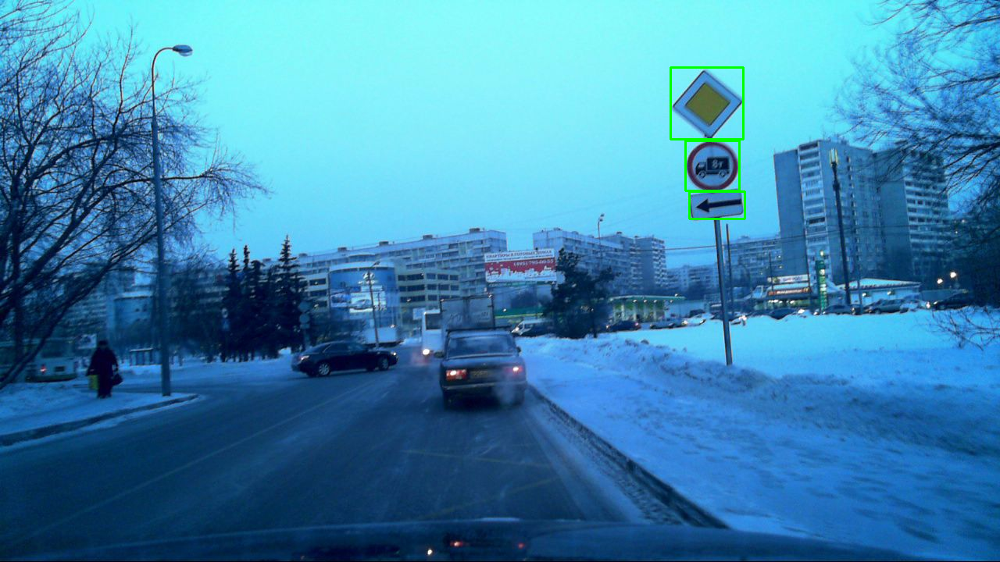

In [ ]:
cv2_imshow(images2[9])

In [ ]:
!mkdir images_with_signs

In [ ]:
cv2.imwrite( "/content/images_with_signs/image0.jpg", images2[3])

True

In [ ]:
create_animation(images2)